# 1. Introduction

## 1.1 Problem Statement

 Average housing starts: The term housing starts refers to the start of construction on a new residential housing unit.

Because new housing is a big-ticket capital good that spurs additional consumer spending on appliances and furniture, it is a key economic indicator closely watched by financial markets participants.


## 1.2 Goal

 Use machine learning to create a model to predict the average housing starts within 1, 2, and 4 quarters.

The data was collected from the Federal Reserve Economic Data (FRED) online database, cleaned in Python notebooks and aggregated to the quarter level. The two crucial data sets (GDP and recession dates) came in quarterly format and only extended to the 1970s, so all other data was also aggregated to the quarter level and dates prior to the 1970s were dropped. To account for the fact that a recession is a function of what happened in the quarters prior, the target column indicating 1 for a recession, and 0 for not a recession was shifted so that the rest of the data would point ahead to whether or not there was a recession. Three different X matrices were created for each shift with 1, 2, and 4 quarters, and the data was split into training and testing sets, and normalized.


## 1.3 Load the data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
df1 = pd.read_csv('/content/all_data.csv')
df1.head()
quarter=df1['quarter']
df1=df1.set_index('quarter')

## 1.4 Dataframe Summary

In [ ]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df1)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
import numpy as np
isnull=df1.isnull().sum() ###to show the number of 'na's 
nullproportion=round(df1.isnull().sum()/len(df1)*100)
result = pd.concat([isnull,nullproportion], axis=1)
print(result)
result.rename(columns={0: '# of null', 1: 'percentage'})

                                              0     1
avg_consumer_price_index                     21   7.0
gdp                                          22   7.0
gdp_pct_change                               23   7.0
avg_housing_starts                           69  22.0
output_gap                                   30  10.0
recession_actual                              3   1.0
avg_unemployment_rate                        25   8.0
fed_funds_avg_rate                           51  16.0
fed_funds_percent_change_prev_quarter        51  16.0
fed_funds_st_dev_rate                        51  16.0
10YT_minus_2YT_avg                          139  45.0
10YT_minus_2YT_percent_change_prev_quarter  139  45.0
real_disp_pers_inc                          140  45.0
personal_consumption_exp_excl_food_energy   140  45.0
tot_public_debt_as_pct_of_gdp               140  45.0
gross_private_domestic_invest               140  45.0
M2_velocity                                 140  45.0
median_sls_price_houses_sold

,# of null,percentage
avg_consumer_price_index,21,7.0
gdp,22,7.0
gdp_pct_change,23,7.0
avg_housing_starts,69,22.0
output_gap,30,10.0
recession_actual,3,1.0
avg_unemployment_rate,25,8.0
fed_funds_avg_rate,51,16.0
fed_funds_percent_change_prev_quarter,51,16.0
fed_funds_st_dev_rate,51,16.0


In [ ]:
#mice imputation
#to handle missing values, MICE or Multiple Imputation by Chained Equation is used assuming hat data is MAR, i.e. missing at random.
###before/after 보여주는 plot
import numpy as np
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import LinearRegression

lr = LinearRegression()
imp = IterativeImputer(estimator=lr,missing_values=np.nan, max_iter=10, verbose=2, imputation_order='roman',random_state=0)
X=imp.fit_transform(df1)


[IterativeImputer] Completing matrix with shape (312, 19)
[IterativeImputer] Ending imputation round 1/10, elapsed time 0.11
[IterativeImputer] Change: 217916.59292127858, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputation round 2/10, elapsed time 0.17
[IterativeImputer] Change: 64232.66121235817, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputation round 3/10, elapsed time 0.40
[IterativeImputer] Change: 32457.34843569947, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputation round 4/10, elapsed time 0.59
[IterativeImputer] Change: 38081.20947358791, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputation round 5/10, elapsed time 0.64
[IterativeImputer] Change: 25849.502127951208, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputation round 6/10, elapsed time 0.75
[IterativeImputer] Change: 14707.35335514399, scaled tolerance: 337.90000000000003 
[IterativeImputer] Ending imputati

/Users/yullie/opt/anaconda3/lib/python3.9/site-packages/sklearn/impute/_iterative.py:699: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


In [ ]:
X

array([[ 1.09869869e+02,  6.13428209e+03,  7.46497084e+00, ...,
         1.67878468e+00,  1.11474787e+05,  4.01444860e+03],
       [ 1.09869869e+02,  6.13428209e+03,  7.46497084e+00, ...,
         1.67878468e+00,  1.11474787e+05,  4.01444860e+03],
       [ 1.09869869e+02,  6.13428209e+03,  7.46497084e+00, ...,
         1.67878468e+00,  1.11474787e+05,  4.01444860e+03],
       ...,
       [ 2.55139333e+02,  2.13402670e+04,  4.70000000e+00, ...,
         1.45700000e+00,  3.22500000e+05,  1.45111760e+04],
       [ 2.56273000e+02,  1.70763067e+04, -1.40344700e-01, ...,
         2.25542560e+00,  2.73135384e+05,  1.14072474e+04],
       [ 1.11058884e+02,  6.33115695e+03,  4.52665330e+00, ...,
         1.63873821e+00,  1.12177421e+05,  4.17797975e+03]])

In [ ]:
#columns as a separate array
columns = ['avg_consumer_price_index', 'gdp', 'gdp_pct_change',
       'avg_housing_starts', 'output_gap', 'recession_actual',
       'avg_unemployment_rate', 'fed_funds_avg_rate',
       'fed_funds_percent_change_prev_quarter', 'fed_funds_st_dev_rate',
       '10YT_minus_2YT_avg', '10YT_minus_2YT_percent_change_prev_quarter',
       'real_disp_pers_inc', 'personal_consumption_exp_excl_food_energy',
       'tot_public_debt_as_pct_of_gdp', 'gross_private_domestic_invest',
       'M2_velocity', 'median_sls_price_houses_sold_US',
       'personal_consumption_expenditures']

np.array(columns)

array(['avg_consumer_price_index', 'gdp', 'gdp_pct_change',
       'avg_housing_starts', 'output_gap', 'recession_actual',
       'avg_unemployment_rate', 'fed_funds_avg_rate',
       'fed_funds_percent_change_prev_quarter', 'fed_funds_st_dev_rate',
       '10YT_minus_2YT_avg', '10YT_minus_2YT_percent_change_prev_quarter',
       'real_disp_pers_inc', 'personal_consumption_exp_excl_food_energy',
       'tot_public_debt_as_pct_of_gdp', 'gross_private_domestic_invest',
       'M2_velocity', 'median_sls_price_houses_sold_US',
       'personal_consumption_expenditures'], dtype='<U42')

In [ ]:
#naming dataframe as df after imputation
df= pd.DataFrame(X,columns = ['avg_consumer_price_index', 'gdp', 'gdp_pct_change',
       'avg_housing_starts', 'output_gap', 'recession_actual',
       'avg_unemployment_rate', 'fed_funds_avg_rate',
       'fed_funds_percent_change_prev_quarter', 'fed_funds_st_dev_rate',
       '10YT_minus_2YT_avg', '10YT_minus_2YT_percent_change_prev_quarter',
       'real_disp_pers_inc', 'personal_consumption_exp_excl_food_energy',
       'tot_public_debt_as_pct_of_gdp', 'gross_private_domestic_invest',
       'M2_velocity', 'median_sls_price_houses_sold_US',
       'personal_consumption_expenditures'])
df.head()

,avg_consumer_price_index,gdp,gdp_pct_change,avg_housing_starts,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,10YT_minus_2YT_percent_change_prev_quarter,real_disp_pers_inc,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures
0,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.0,5.74804,4.398714,0.056029,0.29469,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
1,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.0,5.74804,4.398714,0.056029,0.29469,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
2,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.0,5.74804,4.398714,0.056029,0.29469,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
3,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.0,5.74804,4.398714,0.056029,0.29469,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
4,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.0,5.74804,4.398714,0.056029,0.29469,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596


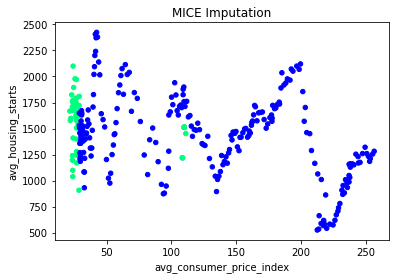

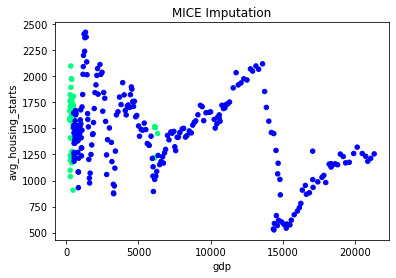

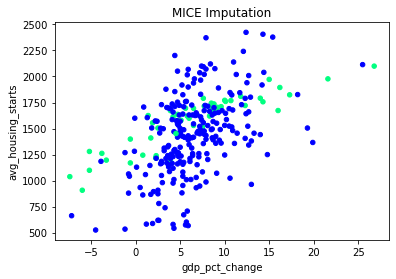

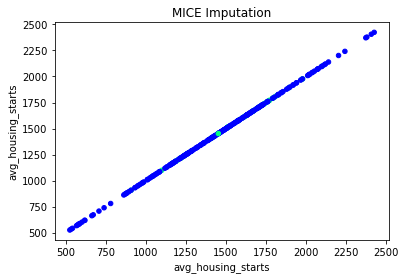

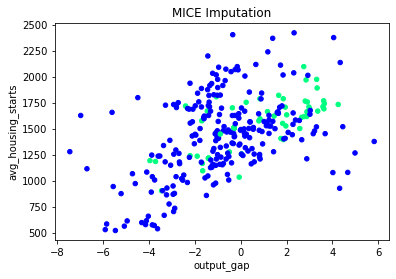

...

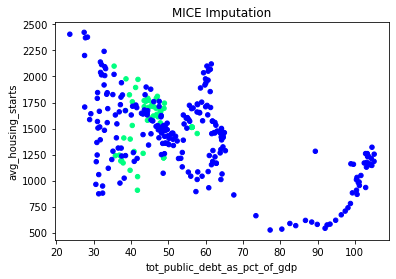

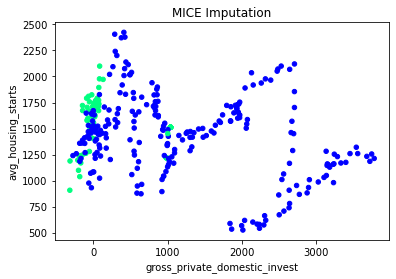

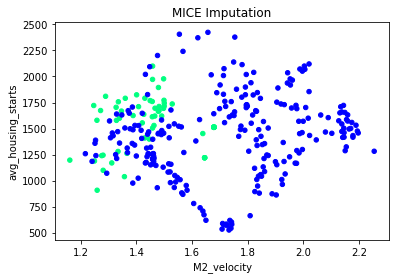

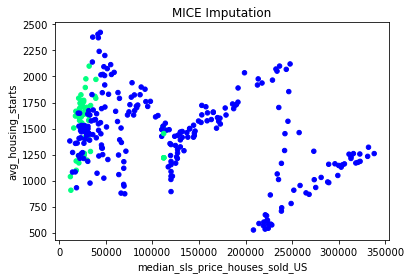

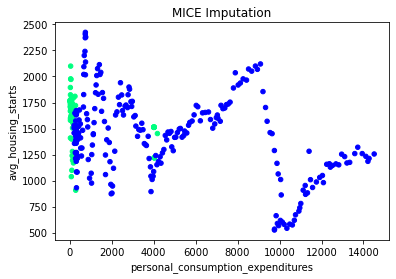

In [ ]:
for i in columns:
    fig = plt.Figure()
    null_values = df1['avg_housing_starts'].isnull()  
    fig = df.plot(x=i, y='avg_housing_starts', kind='scatter', c=null_values, cmap='winter', title='MICE Imputation', colorbar=False)


In [ ]:
import pandas as pd
import statsmodels.api as sm


# Create a function to fit linear regression model for a given column
def fit_linear_regression(column):
    X = df[column].values.reshape(-1, 1)
    y = df['avg_housing_starts'].values
    model = sm.OLS(y, X)
    results = model.fit()
    return results

# Iterate over columns and fit linear regression models
results = {}
for column in df.columns:
    if column != 'avg_housing_starts':
        results[column] = fit_linear_regression(column)


In [ ]:
data = {"variable": [], "pvalue": []}
for column, result in results.items(): 
    pval = result.pvalues[0]
    data["variable"].append(column)
    data["pvalue"].append(pval)
df2 = pd.DataFrame(data)
df2['pval'] = df2["pvalue"].apply(lambda x: "{:.8f}".format(x))
df2['sig_symbol'] = df2["pvalue"].apply(lambda x: "***" if x < 0.001 else ("**" if x < 0.01 else ("*" if x < 0.05 else "")))


In [ ]:
#pvalue table
df2

,variable,pvalue,pval,sig_symbol
0,avg_consumer_price_index,1.256505e-57,0.00000000,***
1,gdp,1.272189e-35,0.00000000,***
2,gdp_pct_change,1.806067e-95,0.00000000,***
3,output_gap,1.089403e-01,0.10894029,
4,recession_actual,4.397344e-11,0.00000000,***
5,avg_unemployment_rate,2.871074e-121,0.00000000,***
6,fed_funds_avg_rate,1.970182e-79,0.00000000,***
7,fed_funds_percent_change_prev_quarter,4.832103e-04,0.00048321,***
8,fed_funds_st_dev_rate,1.248032e-38,0.00000000,***
9,10YT_minus_2YT_avg,3.010876e-45,0.00000000,***


In [ ]:
#setting index

df['quarter']=quarter
df.set_index('quarter')

,avg_consumer_price_index,gdp,gdp_pct_change,avg_housing_starts,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,10YT_minus_2YT_percent_change_prev_quarter,real_disp_pers_inc,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures
quarter,,,,,,,,,,,,,,,,,,,
1942Q1,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.000000,5.748040,4.398714,0.056029,0.294690,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
1942Q2,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.000000,5.748040,4.398714,0.056029,0.294690,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
1942Q3,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.000000,5.748040,4.398714,0.056029,0.294690,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
1942Q4,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.000000,5.748040,4.398714,0.056029,0.294690,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
1943Q1,109.869869,6134.282088,7.464971,1511.994686,-0.280586,0.000000,5.748040,4.398714,0.056029,0.294690,0.973802,-1.327359,2.870728,4.630188,56.343209,1040.871236,1.678785,111474.787136,4014.448596
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018Q4,252.759000,20897.804000,2.900000,1185.000000,0.592021,0.000000,3.566667,2.217097,0.152641,0.066218,0.233333,-0.078947,2.800000,1.900000,105.150260,3725.234000,1.462000,322800.000000,14211.920000
2019Q1,253.311333,21098.827000,3.900000,1213.000000,0.848147,0.000000,4.133333,2.401311,0.083088,0.004646,0.170000,-0.271429,4.500000,1.600000,104.403340,3783.364000,1.458000,313000.000000,14266.250000
2019Q2,255.139333,21340.267000,4.700000,1255.666667,0.828815,0.151039,3.500000,2.397813,-0.001457,0.024002,0.213333,0.254902,2.400000,1.600000,103.200600,3749.471000,1.457000,322500.000000,14511.176000


##### Except for 'output_gap', most variables seem significant in the analysis


# 2 Exploratory Data Analysis(EDA)

## 2.1 Categorical Variables

## 2.2 Numerical Variables

#### `Housing starts`:  measure of new residential construction, and are considered a key economic indicator. 
#### `10YT minus 2yt avg` : positive values may imply future growth, negative values may imply economic downturns.
#### `M2 velocity`: calculated as the ratio of quarterly nominal GDP to the quarterly average of M2 money stock.
#### `Real Disposable Personal Income`:  after tax income

## 2.3 Data Preprocessing 

### 2.3.1. Handling Skewness

In [ ]:
### histogram/ qqplot -> noraml check하는 방법

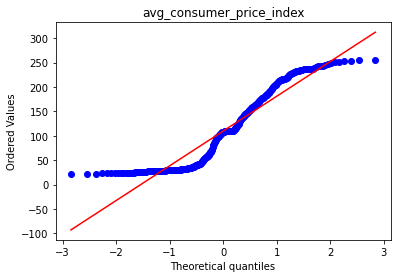

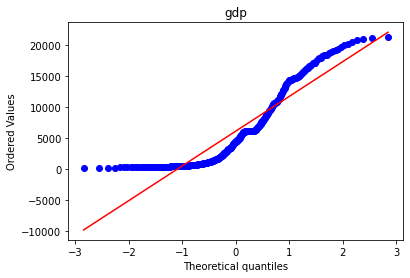

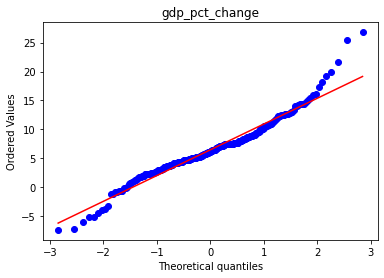

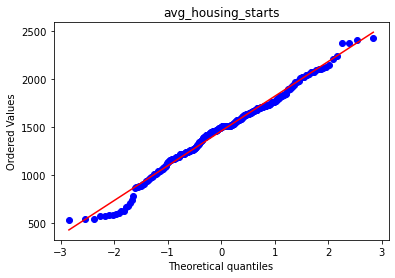

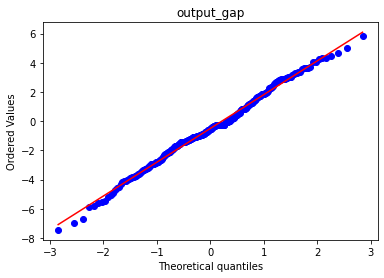

...

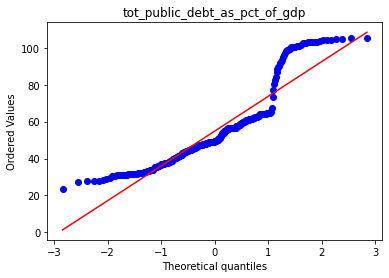

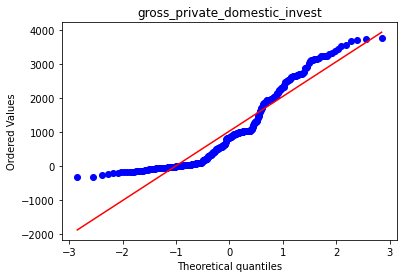

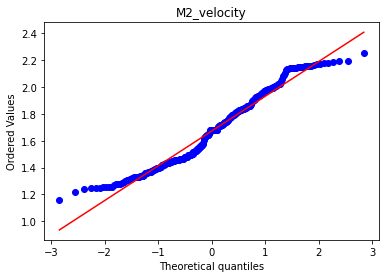

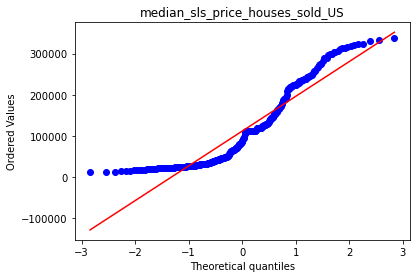

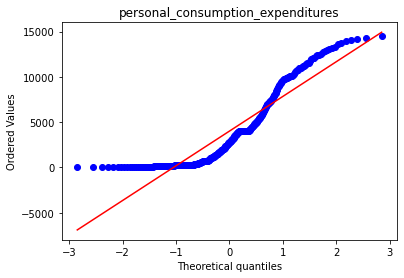

TypeError: ufunc 'true_divide' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

In [ ]:
import matplotlib.pyplot as plt
from scipy.stats import probplot
import pandas as pd

# read data into a pandas dataframe


# loop through columns of dataframe
for col in df.columns:
    data = df[col]
    probplot(data, plot=plt)
    plt.title(col)
    plt.show()


In [ ]:
df.head()

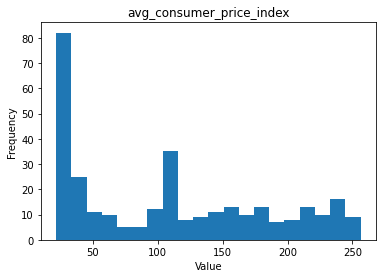

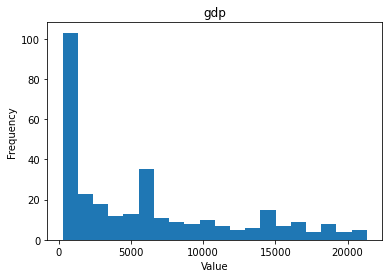

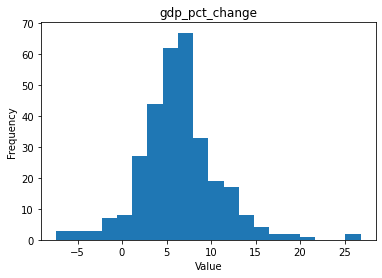

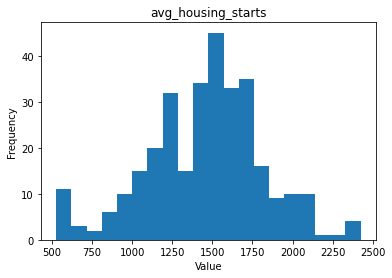

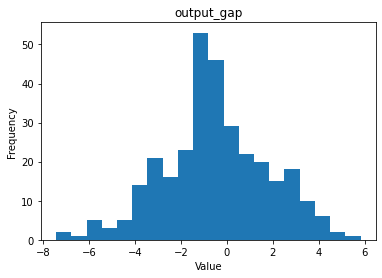

...

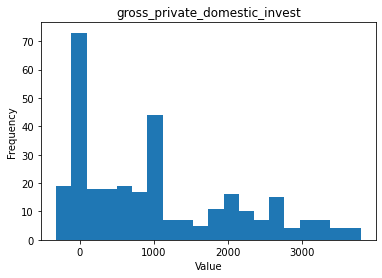

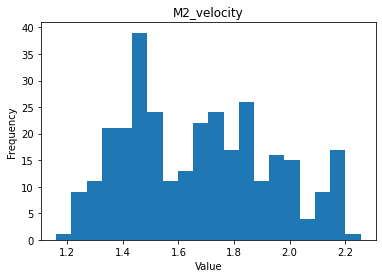

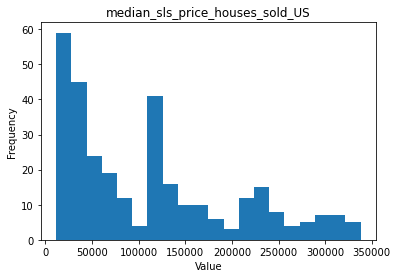

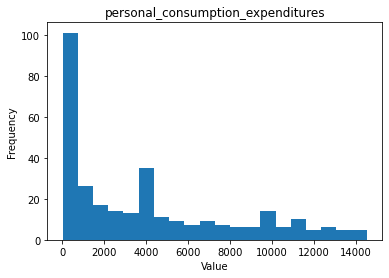

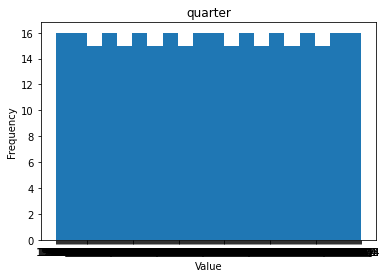

In [ ]:
#histogram

# loop through columns of dataframe
for col in df.columns:
    data = df[col]
    plt.hist(data, bins = 20)
    plt.title(col)
    plt.xlabel("Value")
    plt.ylabel("Frequency")
    plt.show()


### 2.4 Shift Data

In [ ]:
## avg_housing_starts를 low/high 로 나누기 <- vs median price로 (50:50으로 나뉠수 있음)

##outcome2개 recession+avg_housing_starts 
##연속 변수를 왜 categorize
##정보의 loss, interpretation 사람들이 빠르게 이해함. data의 밸런스가 좋아질 수 있음

In [ ]:
# avg housing starts dichotomize by median
def dichotomize(variable):
    variable = np.array(variable)
    median = np.median(variable)
    variable = [1 if i>median else 0 for i in variable]
    return variable
df['avg_housing_starts_cat']=dichotomize(df['avg_housing_starts'])

In [ ]:
df['avg_housing_starts_cat_1q_out'] = df['avg_housing_starts_cat'].shift(-1)
df['avg_housing_starts_cat_2q_out'] = df['avg_housing_starts_cat'].shift(-2)
df['avg_housing_starts_cat_4q_out'] = df['avg_housing_starts_cat'].shift(-4)

In [ ]:
# Save 2019 Q1 & Q2
df_2019 = df.iloc[[-4,-3],:]
df_2019 = df_2019.drop(columns=['avg_housing_starts'])
df_2019

,avg_consumer_price_index,gdp,gdp_pct_change,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,...,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures,quarter,avg_housing_starts_cat,avg_housing_starts_cat_1q_out,avg_housing_starts_cat_2q_out,avg_housing_starts_cat_4q_out
308,253.311333,21098.827,3.9,0.848147,0.000000,4.133333,2.401311,0.083088,0.004646,0.170000,...,104.40334,3783.364,1.458,313000.0,14266.250,2019Q1,0,0.0,0.0,NaN
309,255.139333,21340.267,4.7,0.828815,0.151039,3.500000,2.397813,-0.001457,0.024002,0.213333,...,103.20060,3749.471,1.457,322500.0,14511.176,2019Q2,0,0.0,0.0,NaN


In [ ]:
#df=df.set_index('quarter')
#df_2019=df_2019.set_index('quarter')

df_2019.head()

,avg_consumer_price_index,gdp,gdp_pct_change,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,...,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures,avg_housing_starts_cat,avg_housing_starts_cat_1q_out,avg_housing_starts_cat_2q_out,avg_housing_starts_cat_4q_out
quarter,,,,,,,,,,,,,,,,,,,,,
2019Q1,253.311333,21098.827,3.9,0.848147,0.000000,4.133333,2.401311,0.083088,0.004646,0.170000,...,1.6,104.40334,3783.364,1.458,313000.0,14266.250,0,0.0,0.0,NaN
2019Q2,255.139333,21340.267,4.7,0.828815,0.151039,3.500000,2.397813,-0.001457,0.024002,0.213333,...,1.6,103.20060,3749.471,1.457,322500.0,14511.176,0,0.0,0.0,NaN


In [ ]:
# Create three datasets -- 1 for each model (recession 1Qtr out, 2Qtrs out, 4Qtrs out)
df_q1 = df.drop(columns=['avg_housing_starts_cat_2q_out','avg_housing_starts_cat_4q_out','avg_housing_starts_cat'])
df_q2 = df.drop(columns=['avg_housing_starts_cat_4q_out','avg_housing_starts_cat_1q_out','avg_housing_starts_cat'])
df_q4 = df.drop(columns=['avg_housing_starts_cat_1q_out','avg_housing_starts_cat_2q_out','avg_housing_starts_cat'])

In [ ]:
# Delete missing values
df_q1 = df_q1.dropna()
df_q2 = df_q2.dropna()
df_q4 = df_q4.dropna()

In [ ]:
# Define y variables
y1 = df_q1['avg_housing_starts_cat_1q_out']
y2 = df_q2['avg_housing_starts_cat_2q_out']
y3 = df_q4['avg_housing_starts_cat_4q_out']

In [ ]:
# Define X
X1 = df_q1.drop(columns=['avg_housing_starts_cat_1q_out'])
X2 = df_q2.drop(columns=['avg_housing_starts_cat_2q_out'])
X3 = df_q4.drop(columns=['avg_housing_starts_cat_4q_out'])

### Import Dependencies

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, LSTM, BatchNormalization
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import time
from sklearn.metrics import confusion_matrix, classification_report

2023-01-29 17:59:00.700782: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


### Split and scale data

In [ ]:
# Split data into training and testing
X1_train, X1_test, y1_train, y1_test=train_test_split(X1, y1, train_size=0.8, stratify=y1)
X2_train, X2_test, y2_train, y2_test=train_test_split(X2, y2, train_size=0.8, stratify=y2)
X3_train, X3_test, y3_train, y3_test=train_test_split(X3, y3, train_size=0.8, stratify=y3)

In [ ]:
X1_train

,avg_consumer_price_index,gdp,gdp_pct_change,avg_housing_starts,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,10YT_minus_2YT_percent_change_prev_quarter,real_disp_pers_inc,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures
quarter,,,,,,,,,,,,,,,,,,,
1958Q2,28.930000,471.978,3.9,1188.464576,-3.710247,1.000000,7.400000,0.936923,-0.498912,0.570689,2.820140,-1.376348,-1.341795,8.043761,37.287102,-313.025211,1.248897,18254.237484,305.381009
1986Q2,109.033333,4545.340,3.4,1878.000000,-1.440078,0.000000,7.100000,6.918462,-0.116065,0.174145,0.620000,-0.208511,5.200000,3.600000,45.306820,855.237000,1.760000,92100.000000,2851.456000
1963Q4,30.803333,653.938,6.0,1630.666667,-0.244770,0.000000,5.100000,3.451304,0.037511,0.198606,1.208576,-2.341327,2.100806,7.076788,44.345650,13.162623,1.347294,32945.849424,307.523136
2016Q3,240.601000,18806.743,3.7,1151.333333,-1.087702,0.000000,4.966667,0.394891,0.069179,0.023464,0.836667,-0.146259,1.800000,1.700000,104.076740,3166.606000,1.451000,303800.000000,12822.380000
1957Q3,28.263333,479.490,6.5,1529.744797,1.969053,1.000000,3.833333,3.230761,0.076920,0.255430,0.957143,-2.417376,0.895079,7.397045,40.353745,-48.432971,1.462970,27336.198313,190.159293
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2002Q2,179.466667,10893.207,3.9,1691.000000,-2.080337,0.000000,5.733333,1.751538,0.010762,0.047374,1.876667,0.001779,2.700000,1.600000,56.241190,1933.282000,1.977000,187200.000000,7302.112000
2019Q2,255.139333,21340.267,4.7,1255.666667,0.828815,0.151039,3.500000,2.397813,-0.001457,0.024002,0.213333,0.254902,2.400000,1.600000,103.200600,3749.471000,1.457000,322500.000000,14511.176000
1991Q1,134.766667,6035.178,2.0,894.666667,-3.895584,1.000000,7.200000,6.430444,-0.169555,0.692174,0.983333,0.229167,1.000000,3.900000,57.416520,924.569000,1.826000,120000.000000,3873.562000


In [ ]:
# Create scaler object
X1_scaler = StandardScaler().fit(X1_train)
X2_scaler = StandardScaler().fit(X2_train)
X3_scaler = StandardScaler().fit(X3_train)

#### Reshape data to fit LSTM format

In [ ]:
# Scale training data
X1_train_scaled = X1_scaler.transform(X1_train)
X2_train_scaled = X2_scaler.transform(X2_train)
X3_train_scaled = X3_scaler.transform(X3_train)


In [ ]:
# Scale testing data
X1_test_scaled = X1_scaler.transform(X1_test)
X2_test_scaled = X2_scaler.transform(X2_test)
X3_test_scaled = X3_scaler.transform(X3_test)


In [ ]:
# Scale full X data (no splits)
X1_full_scaled = X1_scaler.transform(X1)
X2_full_scaled = X2_scaler.transform(X2)
X3_full_scaled = X3_scaler.transform(X3)

In [ ]:
# Method to reshape data
def reshape_data(obj):
    reshaped_obj = np.reshape(obj, (obj.shape[0], obj.shape[1], 1))
    return reshaped_obj

In [ ]:
# Reshape training data
reshaped_X1_train_scaled = reshape_data(X1_train_scaled)
reshaped_X2_train_scaled = reshape_data(X2_train_scaled)
reshaped_X3_train_scaled = reshape_data(X3_train_scaled)
# Reshape testing data
reshaped_X1_test_scaled = reshape_data(X1_test_scaled)
reshaped_X2_test_scaled = reshape_data(X2_test_scaled)
reshaped_X3_test_scaled = reshape_data(X3_test_scaled)
# Reshape X_full
reshaped_X1_full = reshape_data(X1_full_scaled)
reshaped_X2_full = reshape_data(X2_full_scaled)
reshaped_X3_full = reshape_data(X3_full_scaled)

Build Model

In [ ]:
# Initialize model
model = Sequential()
# Add layers
model.add(LSTM(128, input_shape=(reshaped_X1_train_scaled.shape[1],1), return_sequences=True))
model.add(Dropout(0.4))
model.add(BatchNormalization())  # Normalize activation outputs

model.add(LSTM(128, return_sequences=True))
model.add(Dropout(0.4))
model.add(BatchNormalization())

model.add(LSTM(128))
model.add(Dropout(0.4))
model.add(BatchNormalization())

model.add(Dense(32, activation='relu'))
model.add(Dropout(0.4))

model.add(Dense(2, activation='softmax'))

In [ ]:
# Compile model
model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=['accuracy'])

## Train and predict on X1-Y1 data (recession 1 quarter out)

In [ ]:
# Fit the model to the training data

model.fit(reshaped_X1_train_scaled, y1_train, validation_split=0.2, epochs=100, shuffle=True, verbose=2)

Epoch 1/100
7/7 - 10s - loss: 0.9524 - accuracy: 0.4848 - val_loss: 0.6890 - val_accuracy: 0.6000 - 10s/epoch - 1s/step
Epoch 2/100
7/7 - 1s - loss: 0.7354 - accuracy: 0.6263 - val_loss: 0.6852 - val_accuracy: 0.7000 - 555ms/epoch - 79ms/step
Epoch 3/100
7/7 - 1s - loss: 0.8336 - accuracy: 0.6162 - val_loss: 0.6870 - val_accuracy: 0.6800 - 524ms/epoch - 75ms/step
Epoch 4/100
7/7 - 1s - loss: 0.6967 - accuracy: 0.6515 - val_loss: 0.6870 - val_accuracy: 0.5400 - 550ms/epoch - 79ms/step
Epoch 5/100
7/7 - 1s - loss: 0.7616 - accuracy: 0.6364 - val_loss: 0.6865 - val_accuracy: 0.5600 - 695ms/epoch - 99ms/step
Epoch 6/100
7/7 - 1s - loss: 0.6390 - accuracy: 0.6919 - val_loss: 0.6841 - val_accuracy: 0.6600 - 562ms/epoch - 80ms/step
Epoch 7/100
7/7 - 1s - loss: 0.6450 - accuracy: 0.6667 - val_loss: 0.6824 - val_accuracy: 0.5800 - 518ms/epoch - 74ms/step
Epoch 8/100
7/7 - 0s - loss: 0.6302 - accuracy: 0.6717 - val_loss: 0.6799 - val_accuracy: 0.6000 - 490ms/epoch - 70ms/step
Epoch 9/100
7/7 - 1

In [ ]:
# Evaluate model using test data
model_loss1, model_accuracy1 = model.evaluate(reshaped_X1_test_scaled, y1_test, verbose=2)

2/2 - 0s - loss: 0.5318 - accuracy: 0.7143 - 85ms/epoch - 42ms/step


In [ ]:
# Make predictions using test data
predictions1_class = (model.predict(reshaped_X1_test_scaled)> 0.5).astype("int32") # Predicted class

2/2 [==============================] - 2s 46ms/step


In [ ]:
print(len(predictions1_class))
print(len(y1_test))

63
63


In [ ]:
#Reshape the arrays
predictions1_class = predictions1_class.reshape(-1)

In [ ]:
# Slicing the larger array
predictions1_class = predictions1_class[:len(y1_test)]

# Create the DataFrame
one_qtr_out = pd.DataFrame({"Predicted": predictions1_class, "Actual": y1_test})


In [ ]:
# Compare results
one_qtr_out = pd.DataFrame({"Predicted":predictions1_class, "Actual":y1_test})
one_qtr_out.loc[one_qtr_out["Actual"]==1]

,Predicted,Actual
quarter,,
1959Q1,0,1.0
1987Q3,1,1.0
1946Q3,0,1.0
1978Q1,1,1.0
1968Q2,0,1.0
1997Q3,0,1.0
2004Q4,1,1.0
1978Q2,1,1.0
1954Q4,0,1.0


### Confusion Matrix on X1-Y1 data (recession 1 quarter out)

In [ ]:
# Create confusion matrix on X1 model
con_mat = confusion_matrix(y1_test, predictions1_class)
print(con_mat)

[[15 17]
 [16 15]]


In [ ]:
# Score model
print(classification_report(y1_test, predictions1_class))

              precision    recall  f1-score   support

         0.0       0.48      0.47      0.48        32
         1.0       0.47      0.48      0.48        31

    accuracy                           0.48        63
   macro avg       0.48      0.48      0.48        63
weighted avg       0.48      0.48      0.48        63



In [ ]:
# Save model
# name1 = f"shuffled-1q-out-{int(time.time())}"
# model.save(f"models/{name1}.h5")

In [ ]:
#modeling

### Predict on 2019

In [ ]:
X1_test.loc[['2019Q1']]

,avg_consumer_price_index,gdp,gdp_pct_change,avg_housing_starts,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,10YT_minus_2YT_percent_change_prev_quarter,real_disp_pers_inc,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures
quarter,,,,,,,,,,,,,,,,,,,
2019Q1,253.311333,21098.827,3.9,1213.0,0.848147,0.0,4.133333,2.401311,0.083088,0.004646,0.17,-0.271429,4.5,1.6,104.40334,3783.364,1.458,313000.0,14266.25


In [ ]:
df_2019

,avg_consumer_price_index,gdp,gdp_pct_change,output_gap,recession_actual,avg_unemployment_rate,fed_funds_avg_rate,fed_funds_percent_change_prev_quarter,fed_funds_st_dev_rate,10YT_minus_2YT_avg,...,personal_consumption_exp_excl_food_energy,tot_public_debt_as_pct_of_gdp,gross_private_domestic_invest,M2_velocity,median_sls_price_houses_sold_US,personal_consumption_expenditures,avg_housing_starts_cat,avg_housing_starts_cat_1q_out,avg_housing_starts_cat_2q_out,avg_housing_starts_cat_4q_out
quarter,,,,,,,,,,,,,,,,,,,,,
2019Q1,253.311333,21098.827,3.9,0.848147,0.000000,4.133333,2.401311,0.083088,0.004646,0.170000,...,1.6,104.40334,3783.364,1.458,313000.0,14266.250,0,0.0,0.0,NaN
2019Q2,255.139333,21340.267,4.7,0.828815,0.151039,3.500000,2.397813,-0.001457,0.024002,0.213333,...,1.6,103.20060,3749.471,1.457,322500.0,14511.176,0,0.0,0.0,NaN


In [ ]:
# Scale 2019 data 
scaled_X1_2019 = X1_scaler.transform(df_2019)

# Reshape 2019 data
reshaped_X1_2019 = reshape_data(scaled_X1_2019)

reshaped_X1_2019=reshaped_X1_2019.tolist()
reshaped_X1_2019
# Predict on 2019
#pred_X1_2019 = model.predict_proba(reshaped_X1_2019)
print(f"2019Q1 No High Probability: {pred_X1_2019[0][0]}")
print(f"2019Q1 High Probability: {pred_X1_2019[0][1]}")
print(f"2019Q2 No High Probability: {pred_X1_2019[1][0]}")
print(f"2019Q2 High Probability: {pred_X1_2019[1][1]}")

/Users/yullie/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: The feature names should match those that were passed during fit. Starting version 1.2, an error will be raised.
Feature names unseen at fit time:
- avg_housing_starts_cat
- avg_housing_starts_cat_1q_out
- avg_housing_starts_cat_2q_out
- avg_housing_starts_cat_4q_out
Feature names seen at fit time, yet now missing:
- avg_housing_starts

  warnings.warn(message, FutureWarning)


ValueError: X has 22 features, but StandardScaler is expecting 19 features as input.

In [ ]:
print(X1.shape)

(311, 19)


In [ ]:
pred_X1_full = model.predict_classes(reshaped_X1_full)

# Preview results
X1_full_results = pd.DataFrame({"Predicted":pred_X1_full, "Actual":y1})
X1_full_results.loc[X1_full_results["Actual"]==1]

# Export results for graphing
# X1_full_results.to_csv(f"resources/predictions/X1_S_{int(time.time())}.csv")

AttributeError: 'Sequential' object has no attribute 'predict_classes'

### Train and predict on X2-Y2 data (recession 2 quarters out)

In [ ]:
# Fit the model to the training data
model.fit(reshaped_X2_train_scaled, y2_train, validation_split=0.2, epochs=100, shuffle=True, verbose=2)

Epoch 1/100
7/7 - 1s - loss: 0.6164 - accuracy: 0.7828 - val_loss: 0.5547 - val_accuracy: 0.7800 - 616ms/epoch - 88ms/step
Epoch 2/100
7/7 - 1s - loss: 0.6954 - accuracy: 0.7273 - val_loss: 0.9876 - val_accuracy: 0.6600 - 778ms/epoch - 111ms/step
Epoch 3/100
7/7 - 1s - loss: 0.6143 - accuracy: 0.7424 - val_loss: 0.7704 - val_accuracy: 0.5800 - 604ms/epoch - 86ms/step
Epoch 4/100
7/7 - 0s - loss: 0.5608 - accuracy: 0.7172 - val_loss: 0.6481 - val_accuracy: 0.6000 - 468ms/epoch - 67ms/step
Epoch 5/100
7/7 - 1s - loss: 0.5206 - accuracy: 0.7475 - val_loss: 0.5849 - val_accuracy: 0.6600 - 522ms/epoch - 75ms/step
Epoch 6/100
7/7 - 1s - loss: 0.4914 - accuracy: 0.7475 - val_loss: 0.5336 - val_accuracy: 0.6800 - 669ms/epoch - 96ms/step
Epoch 7/100
7/7 - 1s - loss: 0.4590 - accuracy: 0.7778 - val_loss: 0.4977 - val_accuracy: 0.7200 - 539ms/epoch - 77ms/step
Epoch 8/100
7/7 - 1s - loss: 0.4574 - accuracy: 0.7374 - val_loss: 0.4751 - val_accuracy: 0.7400 - 683ms/epoch - 98ms/step
Epoch 9/100
7/7

In [ ]:
# Evaluate model using test data
model_loss2, model_accuracy2 = model.evaluate(reshaped_X2_test_scaled, y2_test, verbose=2)

2/2 - 0s - loss: 0.6496 - accuracy: 0.6935 - 86ms/epoch - 43ms/step


In [ ]:
# Make predictions using test data
predictions2_class = model.predict_classes(reshaped_X2_test_scaled)

AttributeError: 'Sequential' object has no attribute 'predict_classes'

### Train and predict on X3-Y3 data (recession 4 quarters out)

In [ ]:
# Fit the model to the training data
model.fit(reshaped_X3_train_scaled, y3_train, validation_split=0.2, epochs=100, shuffle=True, verbose=2)

Epoch 1/100
7/7 - 1s - loss: 0.6104 - accuracy: 0.7908 - val_loss: 0.5584 - val_accuracy: 0.7200 - 684ms/epoch - 98ms/step
Epoch 2/100
7/7 - 1s - loss: 0.5872 - accuracy: 0.7551 - val_loss: 0.5431 - val_accuracy: 0.7400 - 620ms/epoch - 89ms/step
Epoch 3/100
7/7 - 1s - loss: 0.5262 - accuracy: 0.7500 - val_loss: 0.4855 - val_accuracy: 0.7200 - 746ms/epoch - 107ms/step
Epoch 4/100
7/7 - 1s - loss: 0.5530 - accuracy: 0.7041 - val_loss: 0.5169 - val_accuracy: 0.6800 - 676ms/epoch - 97ms/step
Epoch 5/100
7/7 - 1s - loss: 0.4913 - accuracy: 0.7398 - val_loss: 0.4727 - val_accuracy: 0.7200 - 625ms/epoch - 89ms/step
Epoch 6/100
7/7 - 1s - loss: 0.4215 - accuracy: 0.7806 - val_loss: 0.5148 - val_accuracy: 0.7000 - 641ms/epoch - 92ms/step
Epoch 7/100
7/7 - 1s - loss: 0.4081 - accuracy: 0.7908 - val_loss: 0.5178 - val_accuracy: 0.7000 - 608ms/epoch - 87ms/step
Epoch 8/100
7/7 - 1s - loss: 0.4717 - accuracy: 0.7551 - val_loss: 0.5339 - val_accuracy: 0.7200 - 672ms/epoch - 96ms/step
Epoch 9/100
7/7

In [ ]:
# Validate model using test data
model_loss3, model_accuracy3 = model.evaluate(reshaped_X3_test_scaled, y3_test, verbose=2)

In [ ]:
# Make predictions using test data
predictions3_class = model.predict_classes(reshaped_X3_test_scaled)

In [ ]:
# Compare results
four_qtrs_out = pd.DataFrame({"Predicted":predictions3_class, "Actual":y3_test})
four_qtrs_out.loc[four_qtrs_out["Actual"]==1]

### Confusion Matrix on X3-Y3 data (recession 4 quarters out)

In [ ]:
# Create confusion matrix on X3 model
con_mat = confusion_matrix(y3_test, predictions3_class)
print(con_mat)